# 股票交易中的幂律分布

幂律分布公式：$f(x) = ax^{-b}$。对数变换之后，变为$log(f(x)) = log(ax^{-b}) = log(a) -b\times log(x)$.


令$X = log(x)$,$Y = log(f(x))$, $\alpha = log(a)$,那么我们得到 $Y = \alpha - bX$，因此**幂律分布可以通过线性回归来进行拟合**

In [94]:
import datetime
import pandas as pd
import tushare as ts
import sys
import requests
import time

In [3]:
import numpy as np
from sklearn import linear_model

In [18]:
import matplotlib.pyplot as plt

%matplotlib inline

In [58]:
import multiprocessing

In [427]:
from pyecharts.globals import CurrentConfig, NotebookType
CurrentConfig.NOTEBOOK_TYPE = NotebookType.JUPYTER_LAB

import pyecharts.options as opts
from pyecharts.charts import Line

## 定义幂律分布函数以及拟合模型

In [4]:
def power_fit(x,y):
    '''
    params:
    x:自变量，可以是list，也可以是series
    y:因变量，n*1的array
    '''
    X = np.array(np.log(x)).reshape(len(x),1)
    Y = np.array(y)
    # 模型拟合
    regr = linear_model.LinearRegression()
    regr.fit(X, Y)
    # 线性回归模型参数
    print('Coefficients: \n', regr.coef_)
    print("Intercept:\n",regr.intercept_)
    # 计算幂律分布参数  
    a = np.exp(regr.intercept_)
    b = -regr.coef_[0]
    return a,b

In [5]:
# 幂律分布函数
def power_func(x,a,b):
    y = a*(x**-b)
    return y

In [311]:
# 标准化
def norm_func(x):
    mu = np.mean(x)
    std = np.std(x)
    norm_x = (x-mu)/std
    return norm_x

## 获取股票数据

In [365]:
# tushare_token = sys.argv[1]
# 主token，手机号对应
tushare_token = 'c0641675f20fa1b0c0787235e132a60a1242a89bdf953952773d71e5'
# qq号对应的token
# tushare_token = 'c8cb82e60150b37ddf49f042b3ee0f1c3f5d06ba8f4aaee21db7e985'

ts.set_token(tushare_token)

pro = ts.pro_api(tushare_token)

In [354]:
df = pro.trade_cal(exchange='', start_date='20180901', end_date='20181001', fields='exchange,cal_date,is_open,pretrade_date', is_open='0')

In [371]:
# 获取股票在某一天的分笔数据
def get_tick_data(args):
    stock,date = args
    # 历史分笔数据
    df = ts.get_tick_data(stock,date=date,src='tt')
    if type(df) == pd.DataFrame and len(df)>0:
        df['ts'] = date + ' ' + df['time']
        df['ts'] = pd.to_datetime(df['ts'])

        # 将交易时间映射到分钟
        df['date_min'] = df['ts'].apply(lambda x:datetime.datetime(x.year,x.month,x.day,x.hour,x.minute))
    return df

In [372]:
# 绘制折线图
def plot_fitted_data(x,y,y_fit,y_title="",y_fit_title=""):
    # 上午成交额曲线
    line_chart = Line()
    line_chart.set_global_opts(
            tooltip_opts=opts.TooltipOpts(is_show=True),
            xaxis_opts=opts.AxisOpts(type_="category"),
            yaxis_opts=opts.AxisOpts(
                type_="value",
                axistick_opts=opts.AxisTickOpts(is_show=True),
                splitline_opts=opts.SplitLineOpts(is_show=True),
            ),
        )
    line_chart.add_xaxis(xaxis_data=x)
    line_chart.add_yaxis(
            series_name=y_title,
            y_axis=y,
            symbol="emptyCircle",
            is_symbol_show=True,
            label_opts=opts.LabelOpts(is_show=False),
            color = 'blue'
        )
    line_chart.add_yaxis(
            series_name=y_fit_title,
            y_axis=y_fit,
            symbol="emptyCircle",
            is_symbol_show=True,
            label_opts=opts.LabelOpts(is_show=False),
            color = 'red'
        )
    return line_chart

## 抽样单只股票在一个月内的分笔成交额分布

In [461]:
date = '2020-06-05'
stock = '300496'

df = get_tick_data((stock,date))
# 将成交额除以1亿
df['norm_amount'] = df['amount']/100000000

df['return'] = df['change']/df['price'].shift(1)

http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200605


In [458]:
# 当天每分钟成交额
# df_morning = df[(df['time']>='09:30:00')&(df['time']<='11:30:30')]

stats = df.groupby('date_min')['norm_amount'].sum()
x = list(stats.index)
y = list(stats.values)
day_chart = plot_fitted_data(x = x,y = y,y_fit=y)

In [459]:
day_chart.load_javascript()
day_chart.render_notebook()

In [481]:
# 当天分笔收益
fb_return_chart = plot_fitted_data(x = df['time'],y = df['return'],y_fit=df['return'])

fb_return_chart.render_notebook()

#### 一个月内的分笔数据

In [170]:
today = datetime.datetime.today().date()

month_ago = today + datetime.timedelta(days = -30)

In [183]:
date_ls = [str(i.date()) for i in pd.date_range(month_ago,today)]

stock_args = list(zip([stock]*len(date_ls),date_ls))

In [200]:
a = time.time()
with multiprocessing.Pool(cpu_count) as p:
    data_stock = p.map(get_tick_data,stock_args)
b = time.time()
span = b-a
print(f'耗时:{span}秒')

http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200508
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200510
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200509
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200514
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200511
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200507
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200512
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200513
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200515
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200516
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300496&d=20200517
http://stock.gtimg.cn/data/index.php?appn=d

In [486]:
df_stock = pd.concat(data_stock)

df_stock['minute'] = df_stock['ts'].apply(lambda x:datetime.datetime(2020,6,5,x.hour,x.minute))

df_stock['norm_amount'] = df_stock['amount']/100000000

df_stock.sort_values(by='ts',ascending=True,inplace=True)
# 计算分时收益率
df_stock['return'] = df_stock['change']/df_stock['price'].shift(1)

In [476]:
# 1个月内早盘按分钟成交额加总数据
mark_morning = (df_stock['time']<='11:30:30')&(df_stock['time']>='09:30:00')

df_stock_morning = df_stock[mark_morning]
# df_stock_morning = df_stock

df_stock_morning_stats = df_stock_morning.groupby('minute')['norm_amount'].sum()

morning_sum_chart = plot_fitted_data(df_stock_morning_stats.index,df_stock_morning_stats.values,df_stock_morning_stats.values)

morning_sum_chart.render_notebook()

In [487]:
# 1个月内分时收益率

fb_return_1month_chart = plot_fitted_data(x = df_stock['ts'],y = df_stock['return'],y_fit=df_stock['return'])

fb_return_1month_chart.render_notebook()

In [480]:
# 1个月内分时收益率取平均

avg_fb_return = df_stock.groupby('time')['return'].mean()

avg_fb_return_chart = plot_fitted_data(avg_fb_return.index,avg_fb_return.values,avg_fb_return.values)

avg_fb_return_chart.render_notebook()

### 1个月内分笔收益率平均-模型拟合

In [506]:
# 早盘收益率数据
avg_fb_return_morning = df_stock[(df_stock['time']<='11:30:30')&(df_stock['time']>='09:30:00')].groupby('time')['return'].mean()

idx = avg_fb_return_morning.index
x = range(1,len(idx)+1)
y = avg_fb_return_morning
a,b = power_fit(x,y)
y_hat = power_func(x,a,b)

print(a,b)

Coefficients: 
 [-1.72459412e-05]
Intercept:
 0.0001278818027671393
1.0001278899799935 1.7245941210319923e-05


In [507]:
y_norm = norm_func(y)
y_hat_norm = norm_func(y_hat)

In [508]:
fb_avg_return_fitted_chart = plot_fitted_data(idx,y_norm,y_hat_norm,"normalized return","normalized power fit return")

In [509]:
fb_avg_return_fitted_chart.render_notebook()

### 1个月内分钟成交额加总模型拟合

In [310]:

df_amount = df_stock_morning.groupby('minute')['norm_amount'].sum()

idx = df_amount.index

# 模型拟合
x = range(1,len(df_amount)+1)
y = df_amount
a,b = power_fit(x,y)
y_hat = power_func(x,a,b)

print(a,b)

Coefficients: 
 [-0.49685829]
Intercept:
 2.573201621773082
13.107723305316217 0.49685829404589726


### 拟合后的幂律分布函数为：$f(x) = 13.108\times x^{-0.497}$

In [312]:
y_norm = norm_func(y)
y_hat_norm = norm_func(y_hat)

In [429]:
x = [str(i)[11:] for i in idx]
y = y_norm
y_fit = y_hat_norm

In [430]:
fitted_chart = plot_fitted_data(x,y,y_fit,"normalized exchange amount","normalized power fit exchange amount")

In [431]:
fitted_chart.load_javascript()
fitted_chart.render_notebook()

In [229]:
data_output = pd.DataFrame({'ts':idx,'amount_bymin':y,'amount_powerfit':y_hat,'amount_norm':y_norm,'amount_powerfit_norm':y_hat_norm})

In [230]:
data_output.to_csv('中科创达6月份早盘成交额分布.csv',index=False)

## 股票收益率在时间上服从幂律分布吗

In [359]:
stock

'300496'

In [396]:
df = pro.daily(ts_code=f'{stock}.SZ', start_date='20200101', end_date='20200605')

df['date'] = df['trade_date'].apply(lambda x:datetime.datetime.strptime(x,'%Y%m%d'))

df['return'] = df['close'].diff(-1)/df['close'].shift(-1)

In [397]:
# 收益率曲线
x_data = [i.date() for i in df['date'][::-1][1:]]
y_data = [round(i,4) for i in df['return'][::-1][1:]]

return_chart = plot_fitted_data(x_data,y_data,y_data)


In [398]:
return_chart.load_javascript()

return_chart.render_notebook()

## 创业板收益率

In [366]:
df = pro.index_daily(ts_code='399006.SZ', start_date='20200101', end_date='20200605')

In [367]:
df['date'] = df['trade_date'].apply(lambda x:datetime.datetime.strptime(x,'%Y%m%d'))

df['return'] = df['close'].diff(-1)/df['close'].shift(-1)

In [368]:
# 收益率曲线
x_data = [i.date() for i in df['date'][::-1][1:]]
y_data = [round(i,4) for i in df['return'][::-1][1:]]

return_chart = plot_fitted_data(x_data,y_data,y_data)


In [369]:
return_chart.load_javascript()

return_chart.render_notebook()

## 抽样创业板任意300支股票，来看创业板成交额的分布

In [76]:
#查询当前所有正常上市交易的股票列表

data = pro.stock_basic(exchange='', list_status='L', fields='ts_code,symbol,name,area,industry,list_date,market')
data['ipo_date'] = data['list_date'].apply(lambda x:datetime.datetime.strptime(x,'%Y%m%d'))


In [78]:
# 创业板股票列表,并且上市至少6个月
# 筛选至少上市6个月的股票
today = datetime.datetime.today()
halfyear_age = today + datetime.timedelta(days = -180)
mark_cyb = data['market']=='创业板'
mark_halfyear = data['ipo_date']<=halfyear_age
data_cyb = data[mark_cyb&mark_halfyear]

In [77]:
data_cyb.shape

(786, 8)

In [86]:
stock_ls = list(zip(data_cyb['symbol'],[date]*len(data_cyb)))

In [59]:
# 获取创业板股票某一天的历史分笔数据

cpu_count = multiprocessing.cpu_count()

In [96]:
a = time.time()
with multiprocessing.Pool(cpu_count) as p:
    data_cyb_fb = p.map(get_tick_data,stock_ls[:300])
b = time.time()
span = b-a
print(f'耗时:{span}秒')

http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300011&d=20200605
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300001&d=20200605
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300042&d=20200605
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300032&d=20200605
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300021&d=20200605
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300052&d=20200605
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300063&d=20200605
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300073&d=20200605
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300012&d=20200605
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300022&d=20200605
http://stock.gtimg.cn/data/index.php?appn=detail&action=download&c=sz300033&d=20200605
http://stock.gtimg.cn/data/index.php?appn=d

In [129]:
df_cyb_fb = pd.concat(data_cyb_fb,axis=0)

# 归一化，将金额统一处以10亿
df_cyb_fb['norm_amount'] = df_cyb_fb['amount']/1000000000

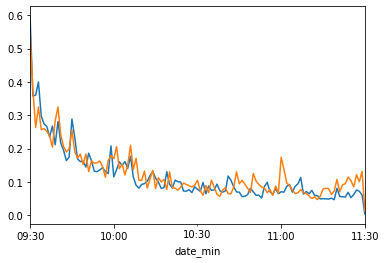

In [130]:
# 早盘数据

mark_morning = (df_cyb_fb['time']<='11:30:30')&(df_cyb_fb['time']>='09:30:00')

df_cyb_fb_morning = df_cyb_fb[mark_morning]

df_cyb_fb_morning.groupby('type')['norm_amount'].sum()

# 买盘数据
df_buy = df_cyb_fb_morning[df_cyb_fb_morning['type']=='买盘']
df_buy.groupby('date_min')['norm_amount'].sum().plot()

# 卖盘数据
df_buy = df_cyb_fb_morning[df_cyb_fb_morning['type']=='卖盘']
df_buy.groupby('date_min')['norm_amount'].sum().plot()

### 早盘成交额拟合幂律分布

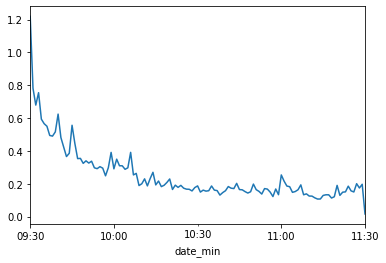

In [131]:
df_cyb_fb_morning.groupby('date_min')['norm_amount'].sum().plot()

In [132]:
df_amount = df_cyb_fb_morning.groupby('date_min')['norm_amount'].sum()

In [151]:
idx = df_amount.index

In [143]:
# 模型拟合
x = range(1,len(df_amount)+1)
y = df_amount
a,b = power_fit(x,y)
y_hat = power_func(x,a,b)

Coefficients: 
 [-0.16796449]
Intercept:
 0.8941899490252803


In [161]:
print(a,b)

2.445354125453383 0.16796448746213613


### 拟合后的幂律分布函数为：$f(x) = 2.45\times x^{-0.17}$

In [148]:
# 标准化
def norm_func(x):
    mu = np.mean(x)
    std = np.std(x)
    norm_x = (x-mu)/std
    return norm_x

In [149]:
y_norm = norm_func(y)
y_hat_norm = norm_func(y_hat)

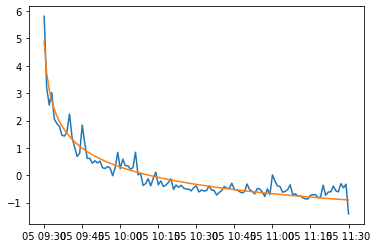

In [154]:
# 标准化之后，在一张图中展示

plt.plot(idx,y_norm)
plt.plot(idx,y_hat_norm)

In [159]:
data_output = pd.DataFrame({'ts':idx,'amount_bymin':y,'amount_powerfit':y_hat,'amount_norm':y_norm,'amount_powerfit_norm':y_hat_norm})

In [160]:
data_output.to_csv('创业板20200605早盘成交额幂律拟合.csv',index=False)

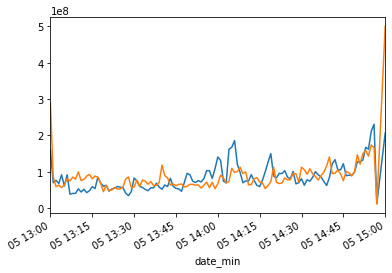

In [115]:
# 下午数据

df_cyb_fb_afternoon = df_cyb_fb[df_cyb_fb['time']>='13:00:00']

df_cyb_fb_afternoon.groupby('type')['amount'].sum()

# 买盘数据
df_buy = df_cyb_fb_afternoon[df_cyb_fb_afternoon['type']=='买盘']
df_buy.groupby('date_min')['amount'].sum().plot()

# 卖盘数据
df_buy = df_cyb_fb_afternoon[df_cyb_fb_afternoon['type']=='卖盘']
df_buy.groupby('date_min')['amount'].sum().plot()